# 3a. 外在分析：OSM 与参考数据的比较

该笔记本将提供的参考自行车基础设施数据集与同一区域的 OSM 数据进行所谓的外部质量评估进行比较。 为了运行这部分分析，必须有一个参考数据集可用于比较。

该分析基于将参考数据集与 OSM 进行比较，并突出显示它们的不同之处，包括自行车基础设施在两个数据集中映射的“程度”以及基础设施“如何”映射，从而查明差异 在网络结构中。

**所有差异都是针对与 OSM 相关的参考数据计算的，以 OSM 数据为基线。** 例如，网络密度的差异是通过计算参考密度减去 OSM 密度来计算的。 因此，正差值（大于0）表示参考值高出多少； 负差值（低于 0）表示参考值低了多少。 因此，如果差异以百分比形式给出，则 OSM 值将被视为总值 (100%)。

虽然分析是基于比较，但它没有对哪个数据集更好做出先验假设。 对于识别出的差异也是如此：BikeDNA 不允许自动得出哪个数据集质量更好的结论，而是要求用户解释发现的差异的含义，例如，不同的特征是否是遗漏错误的结果 或佣金，以及哪个数据集更正确。 然而，许多低值可能表明参考数据的完整性低于 OSM 数据。

目标是确定的差异可用于评估参考数据集和 OSM 数据集的质量，并支持决定应使用哪个数据集进行进一步分析。

<div class="alert alert-block alert-info">
<b>Prerequisites &amp; Input/Output</b>
<p>
外部比较几乎完全基于笔记本 2a 和 2b 的结果，并期望使用先前笔记本中使用的文件路径来存储结果和绘图。 笔记本 1a、2a、1b 和 2b 必须成功运行才能使用此笔记本。 应用概念和指标的详细解释可以在内在分析笔记本（2a 和 2b）中找到。
</p>
</div>

<div class="alert alert-block alert-info">
<b>Familiarity required</b>
<p>
为了正确解释一些空间数据质量指标，需要对该区域有一定的了解。
</p>
</div>



<br />

In [1]:
# Load libraries, settings and data

import json
import pickle
import warnings
from collections import Counter

import contextily as cx
import folium
import geopandas as gpd
import matplotlib as mpl
import matplotlib.colors as colors
import matplotlib.pyplot as plt
import numpy as np
import osmnx as ox
import pandas as pd
import yaml
from matplotlib import cm
from collections import Counter

from src import evaluation_functions as eval_func
from src import graph_functions as graph_func
from src import plotting_functions as plot_func

# Read in dictionaries with settings
%run ../settings/yaml_variables.py
%run ../settings/plotting.py
%run ../settings/tiledict.py
%run ../settings/df_styler.py

# Load data
%run ../settings/load_osmdata.py
%run ../settings/load_refdata.py
%run ../settings/load_results.py

warnings.filterwarnings("ignore")

d:\work\miniconda3\envs\bikeDNA\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
D:\tmp_resource\BikeDNA-main\BikeDNA-main\scripts\settings\plotting.py:49: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmap_name, n)
D:\tmp_resource\BikeDNA-main\BikeDNA-main\scripts\settings\plotting.py:46: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmap_name)
<string>:49: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 

OSM graphs loaded successfully!
OSM data loaded successfully!
Reference graphs loaded successfully!
Reference data loaded successfully!
Results from intrinsic analyses loaded successfully!


**OSM versus reference network**

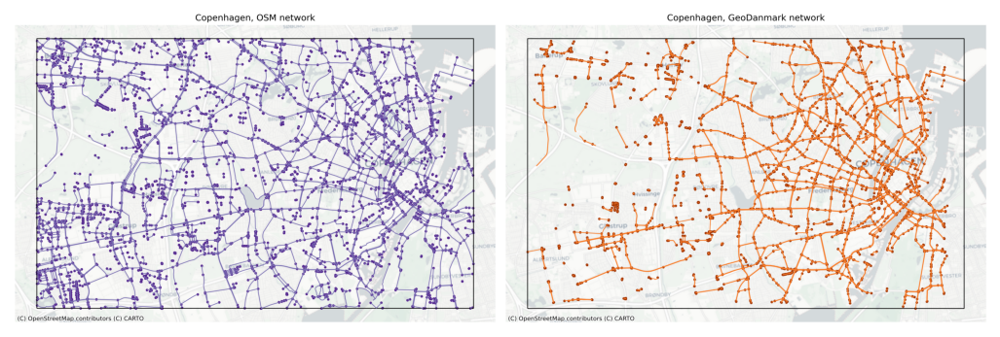

In [2]:
plot_func.plot_saved_maps(
    [
        osm_results_static_maps_fp + "area_network_osm",
        ref_results_static_maps_fp + "area_network_reference",
    ]
)

## 数据完整性

本节从数据完整性方面比较 OSM 和参考数据集。 目标是确定一个数据集是否比另一个数据集映射了更多的自行车基础设施，如果是，这些差异是否集中在某些区域。

本节首先比较两个数据集中基础设施的总长度。 然后，首先在全局（研究区域）和局部（网格单元）级别比较基础设施、节点和悬空节点密度（即每平方公里基础设施/节点的长度）。 最后，分别比较受保护和未受保护的自行车基础设施的密度差异。

计算网格局部密度差异作为数据质量的度量也已被例如应用。 [Haklay (2010)](https://journals-sagepub-com.ep.ituproxy.kb.dk/doi/10.1068/b35097)。

**方法**

为了考虑自行车基础设施映射方式的差异，网络长度和密度的计算基于基础设施长度，而不是网络边缘的几何长度。 例如，一条 100 米长的*双*向路径（几何长度：100m）贡献了 200 米的自行车基础设施（基础设施长度：200m）。

**解释**

密度差异可能表明数据不完整。 例如，如果网格单元在 OSM 中的边缘密度明显高于参考数据集中的边缘密度，则这可能表明参考数据集中未映射、缺失的特征，或者街道在 OSM 中被错误地标记为自行车基础设施。

### 网络长度

In [3]:
plot_func.compare_print_network_length(
    osm_edges_simplified.infrastructure_length.sum(),
    ref_edges_simplified.infrastructure_length.sum(),
)

Length of the OSM data set: 1056.49 km
Length of the reference data set: 626.48 km


The reference data set is 430.01 km shorter than the OSM data set.
The reference data set is 40.70% shorter than the OSM data set.


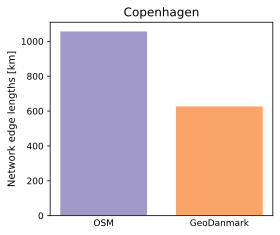

In [4]:
# Plot length comparison

set_renderer(renderer_plot)

bar_labels = ["OSM", reference_name]
x_positions = [1, 2]
bar_colors = [pdict["osm_base"], pdict["ref_base"]]

# Infrastructure length density
data = [osm_edges_simplified.infrastructure_length.sum()/1000,
        ref_edges_simplified.infrastructure_length.sum()/1000
    ]
y_label = "Network edge lengths [km]"
filepath = compare_results_plots_fp + "network_length_compare"
title = area_name

plot = plot_func.make_bar_plot(
    data=data,
    bar_labels=bar_labels,
    y_label=y_label,
    x_positions=x_positions,
    title=title,
    bar_colors=bar_colors,
    filepath=filepath,
    figsize=pdict["fsbar_small"]
)

### 网络密度

#### 全球网络密度

In [5]:
plot_func.print_network_densities(osm_intrinsic_results, "OSM")
plot_func.print_network_densities(ref_intrinsic_results, "reference")

In the OSM data, there are:
 - 5824.58 meters of cycling infrastructure per km2.
 - 27.65 nodes in the cycling network per km2.
 - 10.08 dangling nodes in the cycling network per km2.


In the reference data, there are:
 - 3453.85 meters of cycling infrastructure per km2.
 - 22.74 nodes in the cycling network per km2.
 - 4.80 dangling nodes in the cycling network per km2.




**全球网络密度（每平方公里）**

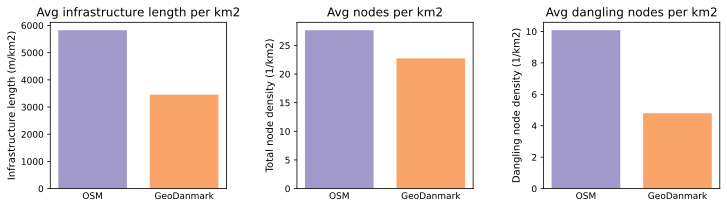

In [6]:
# Plot global difference

set_renderer(renderer_plot)

# Infrastructure length density
subplotdata = [
    (
        osm_intrinsic_results["network_density"]["edge_density_m_sqkm"],
        ref_intrinsic_results["network_density"]["edge_density_m_sqkm"],
    ),
    (
        osm_intrinsic_results["network_density"]["node_density_count_sqkm"],
        ref_intrinsic_results["network_density"]["node_density_count_sqkm"],
    ),
    (
        osm_intrinsic_results["network_density"]["dangling_node_density_count_sqkm"],
        ref_intrinsic_results["network_density"]["dangling_node_density_count_sqkm"],
    ),
]
subplotx_positions = [[1,2] for j in range(3)]
subplotbar_labels = [
    "Infrastructure length (m/km2)",
    "Total node density (1/km2)",
    "Dangling node density (1/km2)",
]
filepath = compare_results_plots_fp + "network_densities_compare"
subplottitle = [
    "Avg infrastructure length per km2",
    "Avg nodes per km2",
    "Avg dangling nodes per km2",
]

plot = plot_func.make_bar_subplots(
    subplot_data=subplotdata,
    nrows=1,
    ncols=3,
    bar_labels=[["OSM", reference_name] for j in range(3)],
    y_label=subplotbar_labels,
    x_positions=subplotx_positions,
    title=subplottitle,
    bar_colors=[pdict["osm_base"], pdict["ref_base"]],
    filepath=filepath,
    wspace=0.4
)

#### 本地网络密度

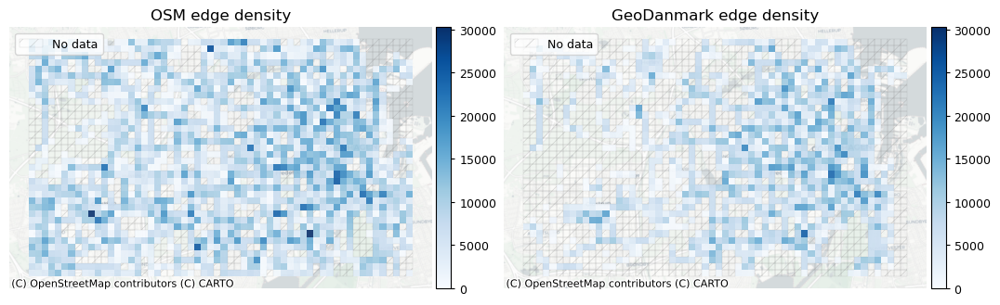

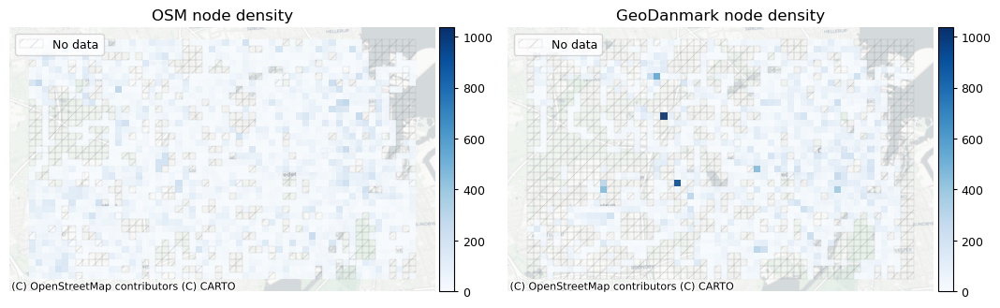

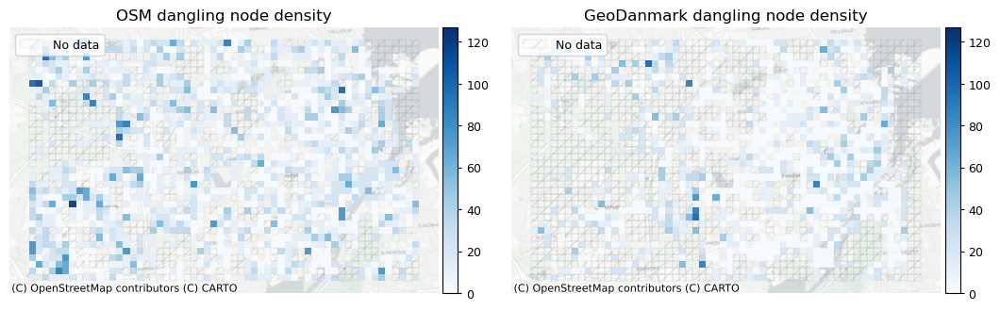

In [7]:
### Plot density comparisons

set_renderer(renderer_map)

# Edge density
plot_cols = ["osm_edge_density", "ref_edge_density"]
plot_func.plot_multiple_grid_results(
    grid=grid,
    plot_cols=plot_cols,
    plot_titles=["OSM edge density", f"{reference_name} edge density"],
    filepath=compare_results_static_maps_fp + "density_edge_compare",
    cmap=pdict["pos"],
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=["count_osm_edges", "count_ref_edges"],
    use_norm=True,
    norm_min=0,
    norm_max = max(grid[plot_cols].max()),
    figsize = pdict["fsmap"],
    legend = False,
)

# Node density
plot_cols = ["osm_node_density", "ref_node_density"]
plot_func.plot_multiple_grid_results(
    grid=grid,
    plot_cols=plot_cols,
    plot_titles=["OSM node density", f"{reference_name} node density"],
    filepath=compare_results_static_maps_fp + "density_node_compare",
    cmap=pdict["pos"],
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=["count_osm_nodes", "count_ref_nodes"],
    use_norm=True,
    norm_min=0,
    norm_max = max(grid[plot_cols].max()),
    figsize = pdict["fsmap"],
    legend = False,
)

# Dangling node density
plot_cols = ["osm_dangling_node_density", "ref_dangling_node_density"]
plot_func.plot_multiple_grid_results(
    grid=grid,
    plot_cols=plot_cols,
    plot_titles=["OSM dangling node density", f"{reference_name} dangling node density"],
    filepath=compare_results_static_maps_fp + "density_danglingnode_compare",
    cmap=pdict["pos"],
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=["count_osm_nodes", "count_ref_nodes"],
    use_norm=True,
    norm_min=0,
    norm_max = max(grid[plot_cols].max()),
    figsize = pdict["fsmap"],
    legend = False,
)

**网络密度的局部差异**

以OSM数据中的密度作为比较基线，绝对差值计算为“参考值”-“OSM值”。 因此，正值表示基础设施类型的参考密度高于 OSM 密度； 负值表示参考密度低于 OSM 密度。

In [8]:
grid["edge_density_diff"] = grid.ref_edge_density.fillna(
    0
) - grid.osm_edge_density.fillna(0)

grid["node_density_diff"] = grid.ref_node_density.fillna(
    0
) - grid.osm_node_density.fillna(0)

grid["dangling_node_density_diff"] = grid.ref_dangling_node_density.fillna(
    0
) - grid.osm_dangling_node_density.fillna(0)

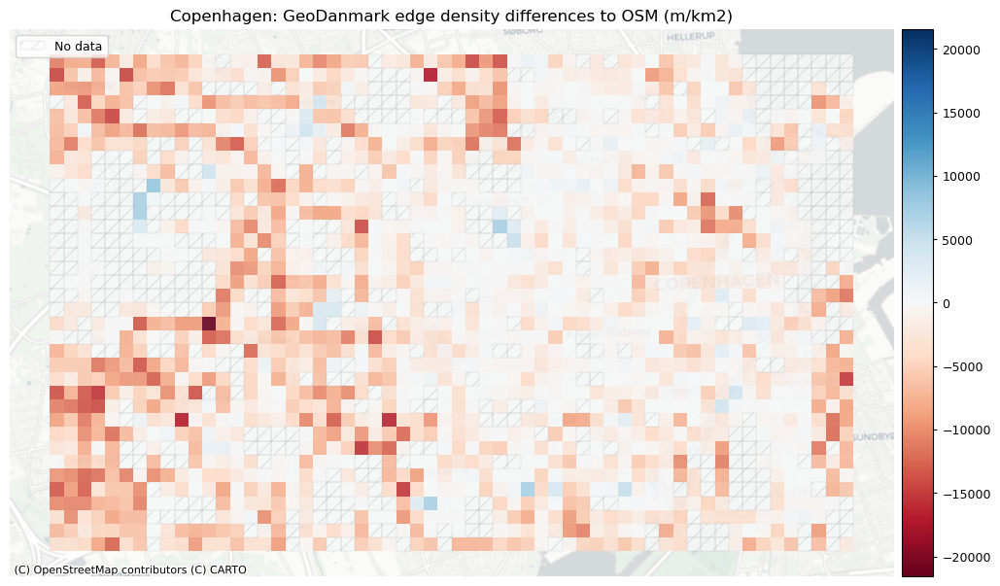

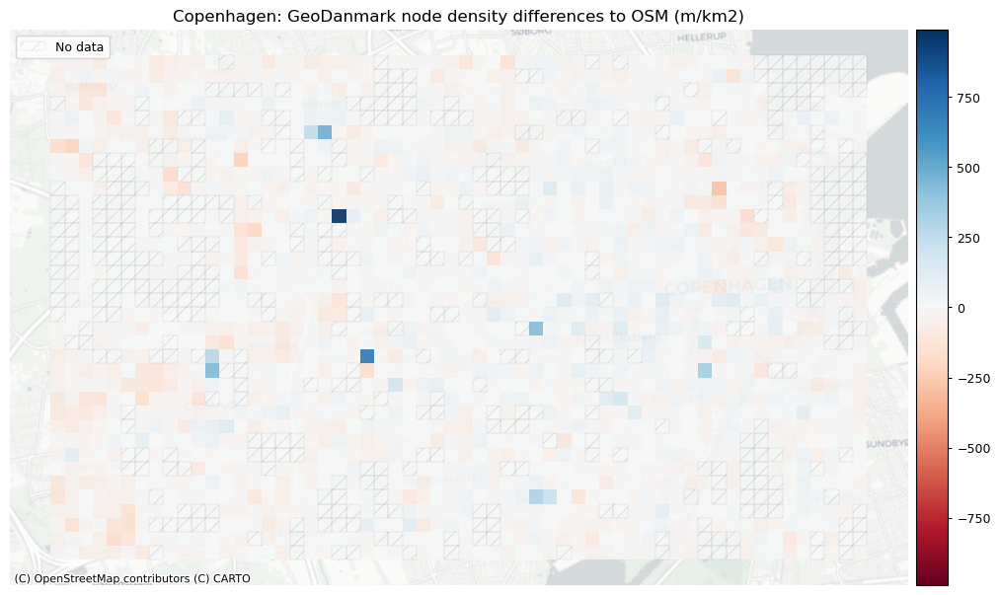

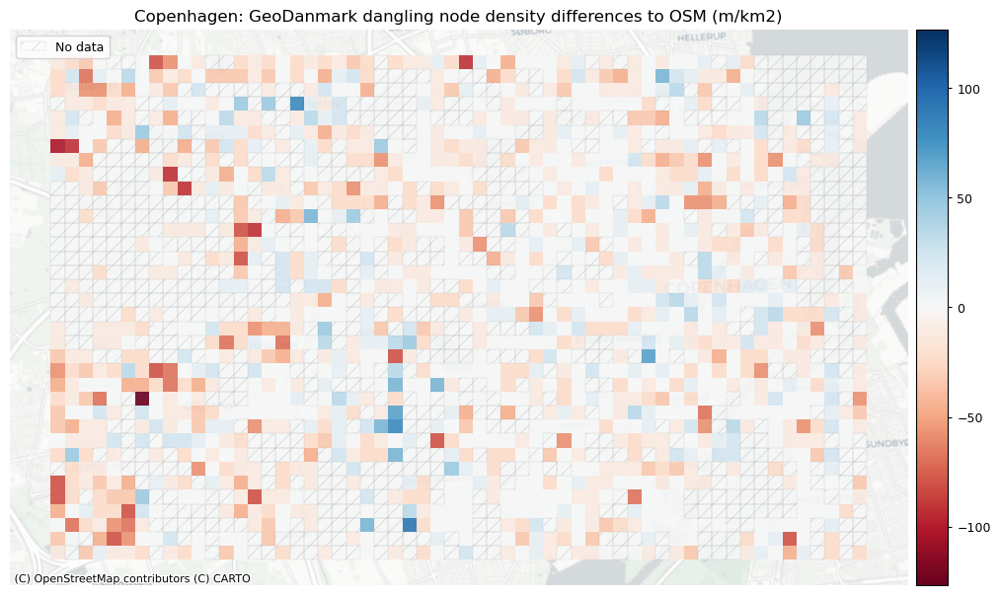

In [9]:
# Network density grid plots

set_renderer(renderer_map)

plot_cols = ["edge_density_diff", "node_density_diff", "dangling_node_density_diff"]
plot_titles = [
    area_name + f": {reference_name} edge density differences to OSM (m/km2)",
    area_name + f": {reference_name} node density differences to OSM (m/km2)",
    area_name + f": {reference_name} dangling node density differences to OSM (m/km2)"
]
filepaths = [
    compare_results_static_maps_fp + "edge_density_compare",
    compare_results_static_maps_fp + "node_density_compare",
    compare_results_static_maps_fp + "dangling_node_density_compare",
]

cmaps = [pdict["diff"]] * 3

# Cols for no-data plots
no_data_cols = [
    ("osm_edge_density", "ref_edge_density"),
    ("osm_node_density", "ref_node_density"),
    ("osm_dangling_node_density", "ref_dangling_node_density"),
]

cblim_edge = max(
    abs(min(grid["edge_density_diff"].fillna(value=0))),
    max(grid["edge_density_diff"].fillna(value=0)),
)

cblim_node = max(
    abs(min(grid["node_density_diff"].fillna(value=0))),
    max(grid["node_density_diff"].fillna(value=0)),
)

cblim_d_node = max(
    abs(min(grid["dangling_node_density_diff"].fillna(value=0))),
    max(grid["dangling_node_density_diff"].fillna(value=0)),
)

norm_min = [-cblim_edge, -cblim_node, -cblim_d_node]
norm_max = [cblim_edge, cblim_node, cblim_d_node]

plot_func.plot_grid_results(
    grid=grid,
    plot_cols=plot_cols,
    plot_titles=plot_titles,
    filepaths=filepaths,
    cmaps=cmaps,
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=no_data_cols,
    use_norm=True,
    norm_min=norm_min,
    norm_max=norm_max,
)

#### 受保护和不受保护的自行车基础设施的密度

**受保护/未受保护基础设施的全球网络密度**

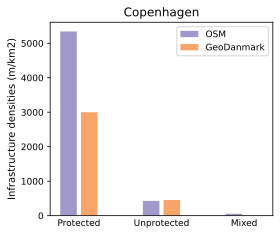

In [10]:
# Plot global differences

set_renderer(renderer_plot)

data_labels = ["protected_density", "unprotected_density", "mixed_density"]
legend_labels = ["OSM", reference_name]
data_osm = [
    osm_intrinsic_results["network_density"][label + "_m_sqkm"] for label in data_labels
]
data_ref = [
    ref_intrinsic_results["network_density"][label + "_m_sqkm"] for label in data_labels
]
bar_colors = [pdict["osm_base"], pdict["ref_base"]]
title = f"{area_name}"

x_labels = ["Protected", "Unprotected", "Mixed"]
x_axis = [np.arange(len(x_labels)) * 2 - 0.25, np.arange(len(x_labels)) * 2 + 0.25]
x_ticks = np.arange(len(x_labels)) * 2

y_label = "Infrastructure densities (m/km2)"

filepath = compare_results_plots_fp + "infrastructure_type_density_diff_compare"

fig = plot_func.make_bar_plot_side(
    x_axis=x_axis,
    data_osm=data_osm,
    data_ref=data_ref,
    bar_colors=bar_colors,
    legend_labels=legend_labels,
    title=title,
    x_ticks=x_ticks,
    x_labels=x_labels,
    x_label=None,
    y_label=y_label,
    filepath=filepath,
    figsize=pdict["fsbar_small"]
)

**受保护/未受保护基础设施的本地网络密度**

No infrastructure is mapped as mixed protected/unprotected in the GeoDanmark data.


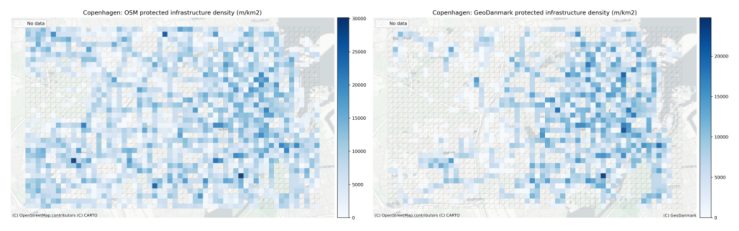

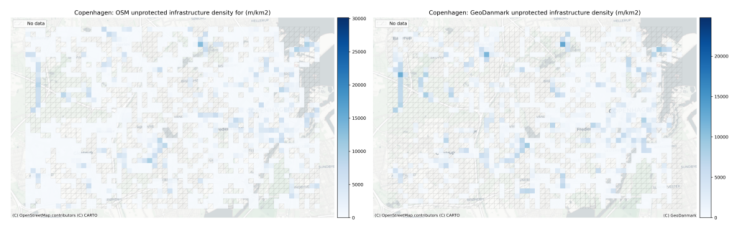

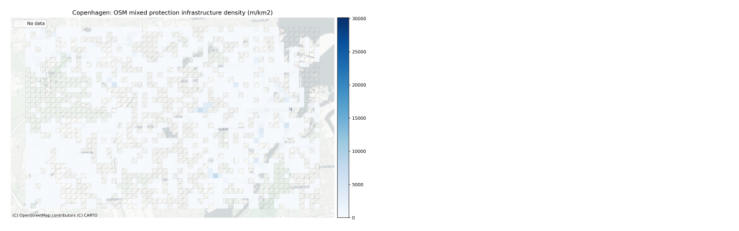

In [11]:
if "ref_protected_density" in grid.columns:

    plot_func.plot_saved_maps(
        [
            osm_results_static_maps_fp + "density_protected_OSM",
            ref_results_static_maps_fp + "density_protected_reference",
        ]
    )

else:
    plot_func.plot_saved_maps(
        [osm_results_static_maps_fp + "density_protected_OSM"] * 2, alpha=[1, 0]
    )
    print(f"No infrastructure is mapped as protected in the {reference_name} data.")


if "ref_unprotected_density" in grid.columns:

    plot_func.plot_saved_maps(
        [
            osm_results_static_maps_fp + "density_unprotected_OSM",
            ref_results_static_maps_fp + "density_unprotected_reference",
        ]
    )

else:
    plot_func.plot_saved_maps(
        [osm_results_static_maps_fp + "density_unprotected_OSM"] * 2, alpha=[1, 0]
    )
    print(f"No infrastructure is mapped as unprotected in the {reference_name} data.")

if "ref_mixed_density" in grid.columns:

    plot_func.plot_saved_maps(
        [
            osm_results_static_maps_fp + "density_mixed_OSM",
            ref_results_static_maps_fp + "density_mixed_reference",
        ]
    )

else:
    plot_func.plot_saved_maps(
        [osm_results_static_maps_fp + "density_mixed_OSM"] * 2, alpha=[1, 0]
    )
    print(f"No infrastructure is mapped as mixed protected/unprotected in the {reference_name} data.")

**基础设施类型密度的差异**

In [12]:
# Computing difference in infrastructure type density

# In case no infrastructure with mixed protected/unprotected exist
if "osm_mixed_density" not in grid.columns:
    grid["osm_mixed_density"] = 0

if "ref_mixed_density" not in grid.columns:
    grid["ref_mixed_density"] = 0

if "ref_protected_density" not in grid.columns:
    grid["ref_protected_density"] = 0

if "ref_unprotected_density" not in grid.columns:
    grid["ref_unprotected_density"] = 0

grid["protected_density_diff"] = grid.ref_protected_density.fillna(
    0
) - grid.osm_protected_density.fillna(0)
grid["unprotected_density_diff"] = grid.ref_unprotected_density.fillna(
    0
) - grid.osm_unprotected_density.fillna(0)
grid["mixed_density_diff"] = grid.ref_mixed_density.fillna(
    0
) - grid.osm_mixed_density.fillna(0)

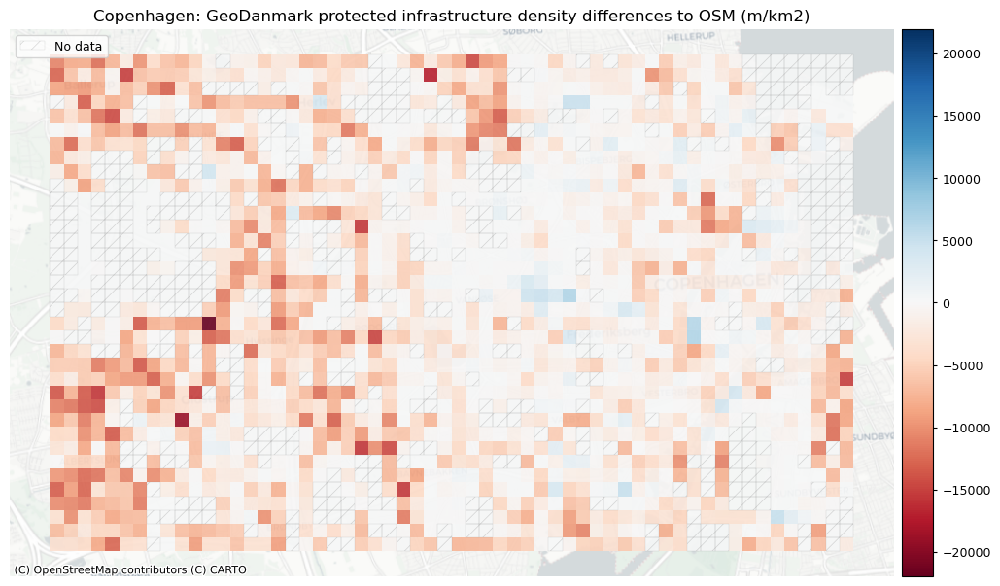

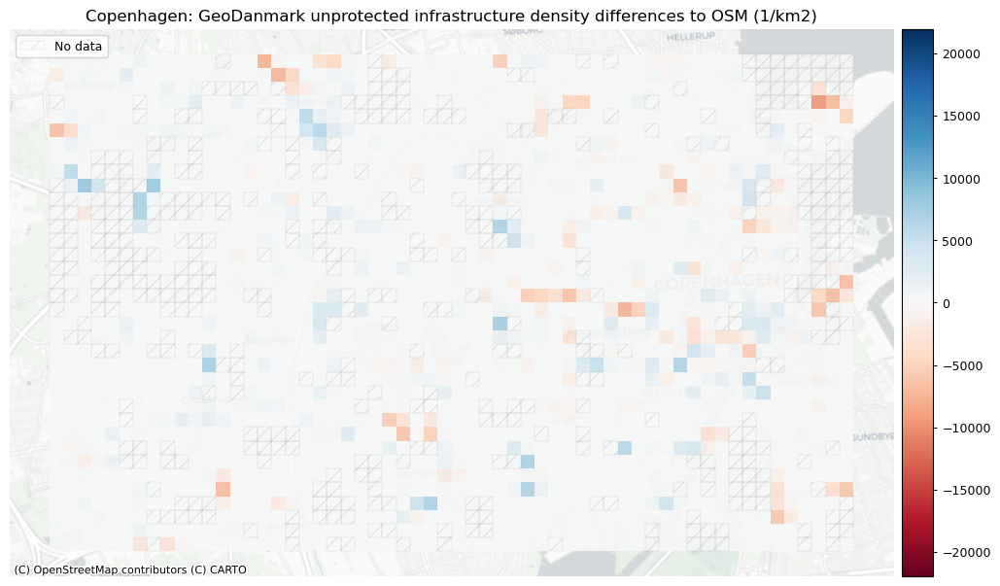

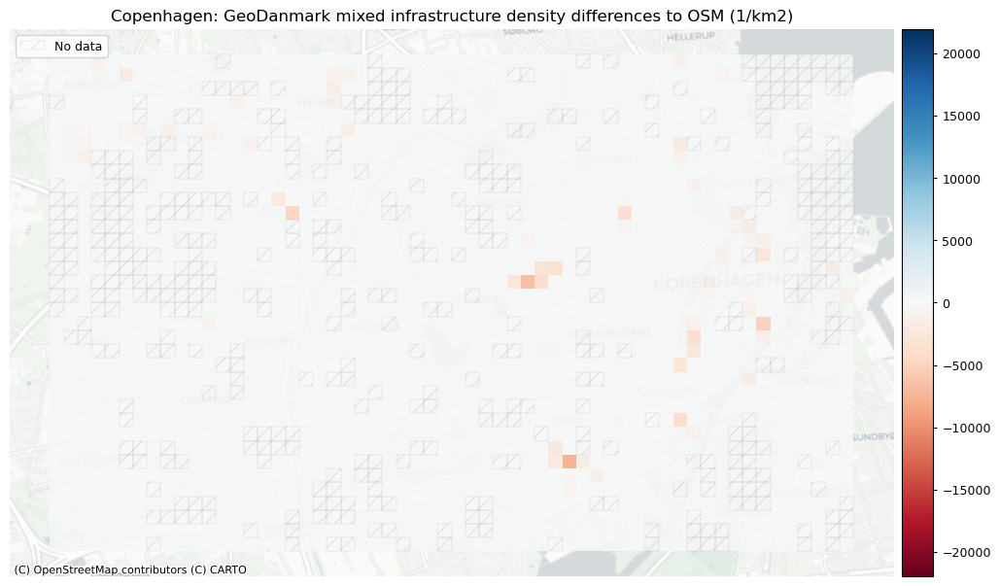

In [13]:
# Infrastructure type density grid plots

set_renderer(renderer_map)

plot_cols = ["protected_density_diff", "unprotected_density_diff", "mixed_density_diff"]
plot_cols = [c for c in plot_cols if c in grid.columns]
plot_titles = [
    area_name + f": {reference_name} protected infrastructure density differences to OSM (m/km2)",
    area_name + f": {reference_name} unprotected infrastructure density differences to OSM (1/km2)",
    area_name + f": {reference_name} mixed infrastructure density differences to OSM (1/km2)",
]

filepaths = [
    compare_results_static_maps_fp + "protected_density_compare",
    compare_results_static_maps_fp + "unprotected_density_compare",
    compare_results_static_maps_fp + "mixed_density_compare",
]

cmaps = [pdict["diff"]] * len(plot_cols)

# Cols for no-data plots
no_data_cols = [
    ("osm_edge_density", "ref_edge_density"),
    ("osm_edge_density", "ref_edge_density"),
    ("osm_edge_density", "ref_edge_density"),
]

# Create symmetrical color range around zero
cblim = max(
    abs(min(grid[plot_cols].fillna(value=0).min())),
    max(grid[plot_cols].fillna(value=0).max()),
)

norm_min = [-cblim] * len(plot_cols)
norm_max = [cblim] * len(plot_cols)

plot_func.plot_grid_results(
    grid=grid,
    plot_cols=plot_cols,
    plot_titles=plot_titles,
    filepaths=filepaths,
    cmaps=cmaps,
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=no_data_cols,
    use_norm=True,
    norm_min=norm_min,
    norm_max=norm_max,
)

## 网络拓扑结构

在比较数据完整性（即映射了“多少”基础设施）之后，这里我们重点关注网络“拓扑”的差异，它提供了有关“如何”基础设施在两个数据集中映射的信息。 在这里，我们还分析网络边与一个或多个其他边连接的程度，或者它们是否以悬空节点结束。 边缘与相邻边缘正确连接的程度对于可访问性和路由分析等非常重要。

在处理自行车网络上的数据时，首选实际连接的网络元素之间没有间隙的数据集 - 当然反映了真实情况。
识别网络中的悬空节点是识别以“死胡同”结束的边缘的快速且简单的方法。 下冲和过冲分别提供了网络间隙和过度延伸边缘的更精确图像，这给出了悬空节点的误导性计数。

**方法**

为了识别数据中潜在的间隙或缺失的链接，首先绘制两个数据集中的悬空节点。 然后，单独绘制每个数据集中所有节点中悬挂节点的局部百分比。 最后，我们显示了悬空节点百分比的局部差异。

OSM 和参考数据中的欠调和过调最终会一起绘制在交互式图中，以供进一步检查。

**解释**

如果一条边在一个数据集中以悬空节点结束，但在另一个数据集中却没有，则表明数据质量存在问题。 数据中缺少连接，或者两条边连接错误。 类似地，悬空节点份额的不同局部率表明自行车网络的映射方式存在差异——尽管在解释中当然应该考虑数据完整性的差异。

下冲是网络数据中误导性差距的明显迹象——尽管它们也可能代表自行车基础设施中的实际差距。 将一个数据集与另一数据集的下冲进行比较可以帮助确定这是数据质量问题还是实际基础设施的质量问题。 交叉口之间存在下冲或间隙的系统差异可能表明不同的数字化策略，因为一些方法会将穿过街道的自行车道绘制为连接的延伸段，而其他方法则会在交叉街道的宽度上引入间隙。 虽然这两种方法都是有效的，但使用前一种方法创建的数据集更适合基于路由的分析。

超调对于分析来说通常不太重要，但大量的超调会引入错误的悬空节点，并扭曲基于节点度或节点与边之间的比率等网络结构的测量。

### 简化结果

<br />

In [14]:
print(
    f"Simplifying the OSM network decreased the number of edges by {osm_intrinsic_results['simplification_outcome']['edge_percent_diff']:.1f}%."
)
print(
    f"Simplifying the OSM network decreased the number of nodes by {osm_intrinsic_results['simplification_outcome']['node_percent_diff']:.1f}%."
)
print("\n")
print(
    f"Simplifying the {reference_name} network decreased the number of edges by {ref_intrinsic_results['simplification_outcome']['edge_percent_diff']:.1f}%."
)
print(
    f"Simplifying the {reference_name} network decreased the number of nodes by {ref_intrinsic_results['simplification_outcome']['node_percent_diff']:.1f}%."
)


Simplifying the OSM network decreased the number of edges by 89.0%.
Simplifying the OSM network decreased the number of nodes by 84.4%.


Simplifying the GeoDanmark network decreased the number of edges by 91.2%.
Simplifying the GeoDanmark network decreased the number of nodes by 92.2%.


**Node degree distribution**

In [15]:
degree_sequence_before_osm = sorted((d for n, d in osm_graph.degree()), reverse=True)
degree_sequence_after_osm = sorted(
    (d for n, d in osm_graph_simplified.degree()), reverse=True
)

degree_sequence_before_ref = sorted((d for n, d in ref_graph.degree()), reverse=True)
degree_sequence_after_ref = sorted(
    (d for n, d in ref_graph_simplified.degree()), reverse=True
)

Note that the two figures below have different y-axis scales.


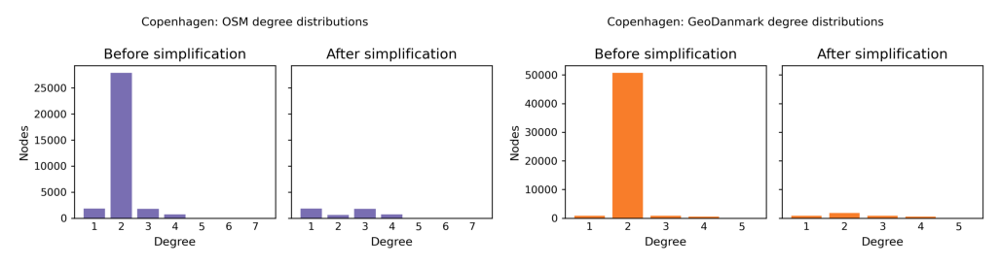

In [16]:
# Display already saved degree distribution plots

print("Note that the two figures below have different y-axis scales.")

plot_func.plot_saved_maps(
    [osm_results_plots_fp + "degree_dist_osm",
     ref_results_plots_fp + "degree_dist_reference"]
)

### Alpha、beta 和 gamma 指数

在本小节中，我们计算并对比三个聚合网络指标 alpha、beta 和 gamma。 这些指标通常用于描述网络结构，但作为数据质量的衡量标准，它们仅在与相应数据集的值进行比较时才有意义。 因此，alpha、beta 和 gamma 仅是外在分析的一部分，不包含在内在笔记本中。

虽然无法根据这三个指标中的任何一个本身得出有关数据质量的结论，但对两个数据集的指标进行比较可以表明网络拓扑的差异，从而表明基础设施映射方式的差异。

#### 方法
所有三个索引均使用“eval_func.compute_alpha_beta_gamma”计算。

**alpha** 值是网络中实际与可能的*周期*的比率。 网络循环被定义为闭环 - 即在其起始节点上结束的路径。 alpha值的范围是0到1。alpha值为0意味着网络根本没有环，即它是一棵树。 alpha 值为 1 意味着网络完全连接，但这种情况很少见。

**beta** 值是网络中现有边与现有节点的比率。 beta的取值范围是0到N-1，其中N是现有节点的数量。 beta值为0意味着网络没有边； Beta 值为 N-1 意味着网络完全连接（另请参见 gamma 值 1）。 beta 值越高，在任意一对节点之间可以选择的不同路径（平均）就越多。

**gamma** 值是网络中现有边与*可能*边的比率。 连接两个现有网络节点的任何边都被定义为“可能”。 因此，gamma 的取值范围为 0 到 1。gamma 值为 0 表示网络没有边；gamma 值为 0 表示网络没有边； gamma 值为 1 意味着网络的每个节点都连接到每个其他节点。

对于所有三个指数，请参阅 [Ducruet 和 Rodrigue，2020](https://transportgeography.org/contents/methods/graph-theory-measures-indices/)。 所有三个指数都可以根据网络连接性进行解释： alpha 值越高，网络中存在的周期越多； beta值越高，路径数量越多，网络复杂度越高； 伽马值越高，任何一对节点之间的边越少。

#### 解释
这些指标并没有过多说明数据质量本身，也对于类似规模的网络的拓扑比较没有用处。 不过，通过比较还是可以得出一些结论。 例如，如果两个网络的索引非常相似，尽管网络例如 具有非常不同的几何长度，这表明数据集是以大致相同的方式映射的，但一个数据集只是比另一个包含更多的特征。 然而，如果网络的总几何长度大致相同，但 alpha、beta 和 gamma 的值不同，则这可能表明两个数据集的结构和拓扑根本不同。


In [17]:
osm_alpha, osm_beta, osm_gamma = eval_func.compute_alpha_beta_gamma(
    edges=osm_edges_simplified,
    nodes=osm_nodes_simplified,
    G=osm_graph_simplified,
    planar=True,
)  # We assume network to be planar or approximately planar

print(f"Alpha for the simplified OSM network: {osm_alpha:.2f}")
print(f"Beta for the simplified OSM network: {osm_beta:.2f}")
print(f"Gamma for the simplified OSM network: {osm_gamma:.2f}")

print("\n")

ref_alpha, ref_beta, ref_gamma = eval_func.compute_alpha_beta_gamma(
    ref_edges_simplified, ref_nodes_simplified, ref_graph_simplified, planar=True
)  # We assume network to be planar or approximately planar

print(f"Alpha for the simplified {reference_name} network: {ref_alpha:.2f}")
print(f"Beta for the simplified {reference_name} network: {ref_beta:.2f}")
print(f"Gamma for the simplified {reference_name} network: {ref_gamma:.2f}")

Alpha for the simplified OSM network: 0.11
Beta for the simplified OSM network: 1.15
Gamma for the simplified OSM network: 0.38


Alpha for the simplified GeoDanmark network: 0.10
Beta for the simplified GeoDanmark network: 1.14
Gamma for the simplified GeoDanmark network: 0.38


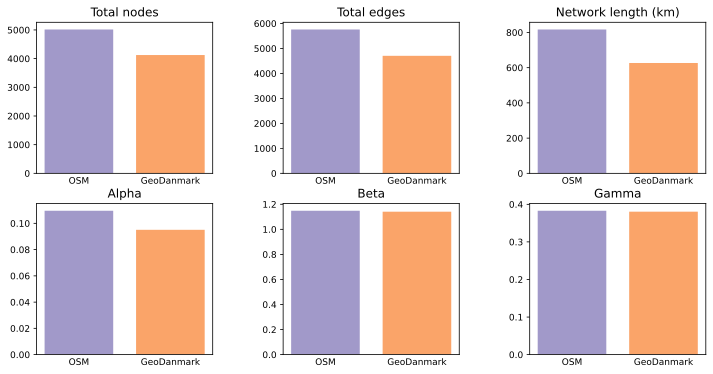

In [18]:
# Plot alpha, beta, gamma

set_renderer(renderer_plot)

bar_labels = ["OSM", reference_name]

bar_colors = [pdict["osm_base"], pdict["ref_base"]]

subplot_data = [
    (len(osm_nodes_simplified), len(ref_nodes_simplified)),
    (len(osm_edges_simplified), len(ref_edges_simplified)),
    (
        osm_edges_simplified.geometry.length.sum()/1000,
        ref_edges_simplified.geometry.length.sum()/1000,
    ),
    (osm_alpha, ref_alpha),
    (osm_beta, ref_beta),
    (osm_gamma, ref_gamma),
]
y_label = [
    "",
    "",
    "",
    "",
    "",
    "",
]
subplottitle = ["Total nodes", "Total edges", "Network length (km)", "Alpha", "Beta", "Gamma"]
filepath = compare_results_plots_fp + "alpha_beta_gamma"

plot = plot_func.make_bar_subplots(
    subplot_data=subplot_data,
    nrows=2,
    ncols=3,
    bar_labels=[["OSM", reference_name] for j in range(6)],
    y_label=y_label,
    x_positions=[[1,2] for j in range(6)],
    title=subplottitle,
    bar_colors=bar_colors,
    filepath=filepath,
    wspace=0.4
);

### 悬空节点

In [19]:
osm_dangling_nodes = gpd.read_file(osm_results_data_fp + "dangling_nodes.gpkg")
ref_dangling_nodes = gpd.read_file(ref_results_data_fp + "dangling_nodes.gpkg")

**OSM 和参考网络中的悬空节点**

In [20]:
# Interactive plot of dangling nodes

osm_edges_simplified_folium = plot_func.make_edgefeaturegroup(
    gdf=osm_edges_simplified,
    mycolor=pdict["osm_base"],
    myweight=pdict["line_base"],
    nametag="OSM edges",
    show_edges=True,
)

osm_nodes_simplified_folium = plot_func.make_nodefeaturegroup(
    gdf=osm_nodes_simplified,
    mysize=pdict["mark_base"],
    mycolor=pdict["osm_base"],
    nametag="OSM all nodes",
    show_nodes=True,
)

osm_dangling_nodes_folium = plot_func.make_nodefeaturegroup(
    gdf=osm_dangling_nodes,
    mysize=pdict["mark_emp"],
    mycolor=pdict["osm_contrast"],
    nametag="OSM dangling nodes",
    show_nodes=True,
)

ref_edges_simplified_folium = plot_func.make_edgefeaturegroup(
    gdf=ref_edges_simplified,
    mycolor=pdict["ref_base"],
    myweight=pdict["line_base"],
    nametag="Reference edges",
    show_edges=True,
)

ref_nodes_simplified_folium = plot_func.make_nodefeaturegroup(
    gdf=ref_nodes_simplified,
    mysize=pdict["mark_base"],
    mycolor=pdict["ref_base"],
    nametag="Reference all nodes",
    show_nodes=True,
)

ref_dangling_nodes_folium = plot_func.make_nodefeaturegroup(
    gdf=ref_dangling_nodes,
    mysize=pdict["mark_emp"],
    mycolor=pdict["ref_contrast2"],
    nametag="Reference dangling nodes",
    show_nodes=True,
)

m = plot_func.make_foliumplot(
    feature_groups=[
        osm_edges_simplified_folium,
        osm_nodes_simplified_folium,
        osm_dangling_nodes_folium,
        ref_edges_simplified_folium,
        ref_nodes_simplified_folium,
        ref_dangling_nodes_folium,
    ],
    layers_dict=folium_layers,
    center_gdf=osm_nodes_simplified,
    center_crs=osm_nodes_simplified.crs,
)

bounds = plot_func.compute_folium_bounds(osm_nodes_simplified)
m.fit_bounds(bounds)
m.save(compare_results_inter_maps_fp + "danglingmap_compare.html")

display(m)

In [21]:
print("Interactive map saved at " + compare_results_inter_maps_fp.lstrip("../") + "danglingmap_compare.html")

Interactive map saved at results/COMPARE/cph_geodk/maps_interactive/danglingmap_compare.html


#### 悬空节点的局部值

In [22]:
# Compute pct difference relative to OSM

grid["dangling_nodes_diff_pct"] = np.round(
    100
    * (grid.count_ref_dangling_nodes - grid.count_osm_dangling_nodes)
    / grid.count_osm_dangling_nodes,
    2,
)

**悬空节点占所有节点的百分比**

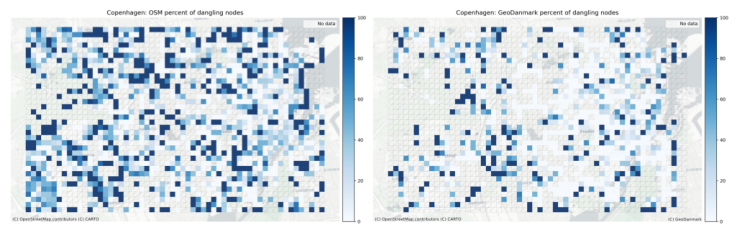

In [23]:
plot_func.plot_saved_maps(
    [
        osm_results_static_maps_fp + "pct_dangling_nodes_osm",
        ref_results_static_maps_fp + "pct_dangling_nodes_reference",
    ]
)

**悬空节点百分比的局部差异**

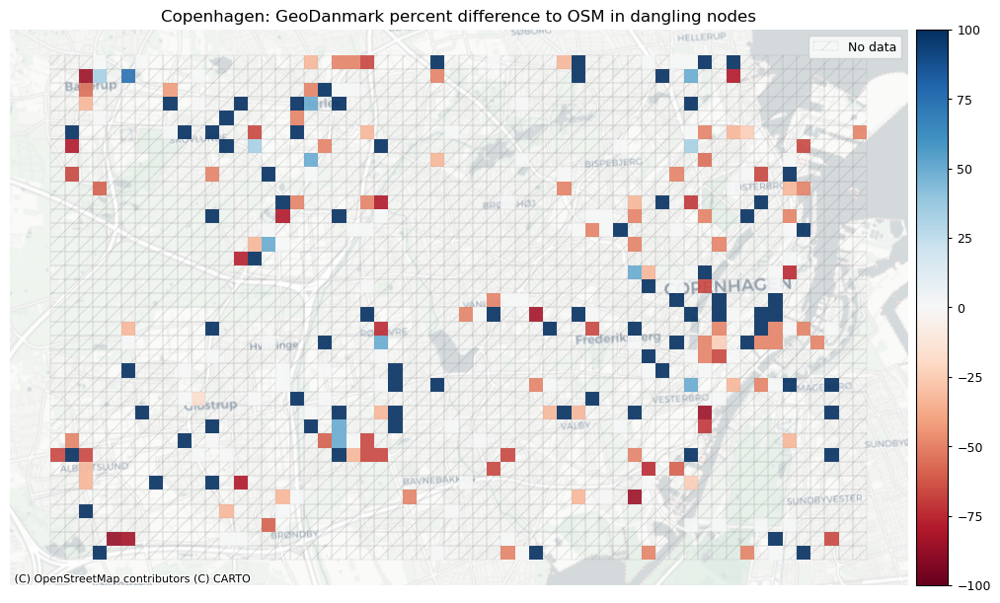

In [24]:
# Plot

set_renderer(renderer_map)

# norm color bar
cbnorm_dang_diff = colors.Normalize(vmin=-100, vmax=100)  # from -max to +max

fig, ax = plt.subplots(1, figsize=pdict["fsmap"])
from mpl_toolkits.axes_grid1 import make_axes_locatable
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="3.5%", pad="1%")

grid.plot(
    cax=cax,
    ax=ax,
    alpha=pdict["alpha_grid"],
    column="dangling_nodes_diff_pct",
    cmap=pdict["diff"],
    legend=True,
    norm=cbnorm_dang_diff,
)

# Add no data patches
grid[grid["dangling_nodes_diff_pct"].isnull()].plot(
    cax=cax,
    ax=ax,
    facecolor=pdict["nodata_face"],
    edgecolor=pdict["nodata_edge"],
    linewidth= pdict["line_nodata"],
    hatch=pdict["nodata_hatch"],
    alpha=pdict["alpha_nodata"],
)

ax.legend(handles=[nodata_patch], loc="upper right")

ax.set_title(
    area_name + f": {reference_name} percent difference to OSM in dangling nodes"
)
ax.set_axis_off()
cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)

plot_func.save_fig(fig, compare_results_static_maps_fp + "dangling_nodes_pct_diff_compare")

### 下冲/过冲

In [25]:
# USER INPUT: LENGTH TOLERANCE FOR OVER- AND UNDERSHOOTS
length_tolerance_over = 3
length_tolerance_under = 3

for s in [length_tolerance_over, length_tolerance_under]:
    assert isinstance(s, int) or isinstance(s, float), print(
        "Settings must be integer or float values!"
    )

In [26]:
osm_overshoot_ids = pd.read_csv(
    osm_results_data_fp + f"overshoot_edges_{length_tolerance_over}.csv"
)["edge_id"].to_list()
osm_undershoot_ids = pd.read_csv(
    osm_results_data_fp + f"undershoot_nodes_{length_tolerance_under}.csv"
)["node_id"].to_list()

ref_overshoot_ids = pd.read_csv(
    ref_results_data_fp + f"overshoot_edges_{length_tolerance_over}.csv"
)["edge_id"].to_list()
ref_undershoot_ids = pd.read_csv(
    ref_results_data_fp + f"undershoot_nodes_{length_tolerance_under}.csv"
)["node_id"].to_list()

osm_overshoots = osm_edges_simplified.loc[
    osm_edges_simplified.edge_id.isin(osm_overshoot_ids)
]
ref_overshoots = ref_edges_simplified.loc[
    ref_edges_simplified.edge_id.isin(ref_overshoot_ids)
]
ref_undershoots = ref_nodes_simplified.loc[
    ref_nodes_simplified.nodeID.isin(ref_undershoot_ids)
]
osm_undershoots = osm_nodes_simplified.loc[
    osm_nodes_simplified.osmid.isin(osm_undershoot_ids)
]

**OSM 和参考网络中的过冲和下冲**

In [27]:
# Interactive plot of over/undershoots

feature_groups = []

# OSM feature groups
osm_edges_simplified_folium = plot_func.make_edgefeaturegroup(
    gdf=osm_edges_simplified,
    mycolor=pdict["osm_base"],
    myweight=pdict["line_base"],
    nametag="OSM network",
    show_edges=True,
)

feature_groups.append(osm_edges_simplified_folium)


if len(osm_overshoots) > 0:
    osm_overshoots_folium = plot_func.make_edgefeaturegroup(
        gdf=osm_overshoots,
        mycolor=pdict["osm_contrast"],
        myweight=pdict["line_emp"],
        nametag="OSM overshoots",
        show_edges=True,
    )

    feature_groups.append(osm_overshoots_folium)

if len(osm_undershoots) > 0:
    osm_undershoot_nodes_folium = plot_func.make_nodefeaturegroup(
        gdf=osm_undershoots,
        mysize=pdict["mark_emp"],
        mycolor=pdict["osm_contrast2"],
        nametag="OSM undershoot nodes",
        show_nodes=True,
    )

    feature_groups.append(osm_undershoot_nodes_folium)


# Reference feature groups
ref_edges_simplified_folium = plot_func.make_edgefeaturegroup(
    gdf=ref_edges_simplified,
    mycolor=pdict["ref_base"],
    myweight=pdict["line_base"],
    nametag=f"{reference_name} network",
    show_edges=True,
)

feature_groups.append(ref_edges_simplified_folium)

if len(ref_overshoots) > 0:
    ref_overshoots_folium = plot_func.make_edgefeaturegroup(
        gdf=ref_overshoots,
        mycolor=pdict["ref_contrast"],
        myweight=pdict["line_emp"],
        nametag=f"{reference_name} overshoots",
        show_edges=True,
    )

    feature_groups.append(ref_overshoots_folium)

if len(ref_undershoots) > 0:

    ref_undershoot_nodes_folium = plot_func.make_nodefeaturegroup(
        gdf=ref_undershoots,
        mysize=pdict["mark_emp"],
        mycolor=pdict["ref_contrast2"],
        nametag=f"{reference_name} undershoot nodes",
        show_nodes=True,
    )

    feature_groups.append(ref_undershoot_nodes_folium)

m = plot_func.make_foliumplot(
    feature_groups=feature_groups,
    layers_dict=folium_layers,
    center_gdf=osm_nodes_simplified,
    center_crs=osm_nodes_simplified.crs,
)

bounds = plot_func.compute_folium_bounds(osm_nodes_simplified)
m.fit_bounds(bounds)

m.save(
    compare_results_inter_maps_fp
    + f"overundershoots_{length_tolerance_over}_{length_tolerance_under}_compare.html"
)

display(m)

In [28]:
print("Interactive map saved at " + compare_results_inter_maps_fp.lstrip("../")
    + f"overundershoots_{length_tolerance_over}_{length_tolerance_under}_compare.html")

Interactive map saved at results/COMPARE/cph_geodk/maps_interactive/overundershoots_3_3_compare.html


## 网络组件

本节仔细研究两个数据集的网络组件特征。

断开连接的组件不共享任何元素（节点/边）。 换句话说，不存在可以从一个断开连接的组件通向另一组件的网络路径。 如上所述，大多数现实世界的自行车基础设施网络确实由许多断开连接的组件组成（[Natera Orozco et al., 2020](https://onlinelibrary.wiley.com/doi/pdfdirect/10.1111/gean.12324)） 。 然而，当两个断开的组件彼此非常接近时，这可能是边缘缺失或另一个数字化错误的迹象。

**方法**

为了比较 OSM 和参考数据中断开组件的数量和模式，将内在分析的所有组件结果并置，并生成两个新图，分别显示 OSM 和参考数据的组件间隙以及组件连接性的差异。

**解释**

许多自行车网络的分散性使得很难评估断开的组件是否是由于缺乏数据质量或缺乏正确连接的自行车基础设施而导致的问题。 比较两个数据集中的断开组件可以更准确地评估断开组件是数据问题还是规划问题。

<br />

### 断开的组件

In [29]:
print(
    f"The OSM network in the study area consists of {osm_intrinsic_results['component_analysis']['component_count']} disconnected components."
)
print(
    f"The {reference_name} network in the study area consists of {ref_intrinsic_results['component_analysis']['component_count']} disconnected components."
)

The OSM network in the study area consists of 356 disconnected components.
The GeoDanmark network in the study area consists of 204 disconnected components.


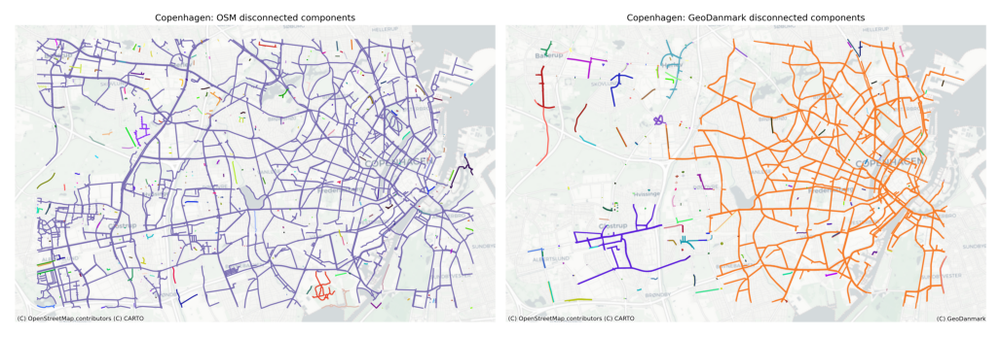

In [30]:
plot_func.plot_saved_maps(
    [
        osm_results_static_maps_fp + "all_components_osm",
        ref_results_static_maps_fp + "all_components_reference",
    ]
)

### 组件长度分布

所有网络组件长度的分布可以在所谓的 *Zipf 图* 中可视化，该图按等级对每个组件的长度进行排序，在左侧显示最大组件的长度，然后是第二大组件的长度，依此类推，直到 右侧最小组件的长度。 当 Zipf 图遵循 [双对数比例](https://en.wikipedia.org/wiki/Logarithmic_scale) 中的直线时，这意味着找到小的不连续组件的机会比传统分布的预期要高得多 [(Clauset et al., 2009)]( https://epubs.siam.org/doi/abs/10.1137/070710111)。 这可能意味着网络没有合并，只有分段或随机添加  [(Szell et al., 2022)](https://www.nature.com/articles/s41598-022-10783-y)，或者数据本身存在许多间隙和拓扑错误，导致小的断开组件。

但是，也可能发生最大的连通分量（图中最左边的标记，等级为 $10^0$）是明显的异常值，而图的其余部分则遵循不同的形状。 这可能意味着在基础设施层面，大部分基础设施已连接到一个大型组件，并且数据反映了这一点 - 即数据在很大程度上没有受到间隙和缺失链接的影响。 自行车网络也可能介于两者之间，有几个大型组件作为异常值。

在对同一区域进行比较时，如下所示，如果一个数据集在其最大连通分量中显示出明显的异常值，而另一个数据集则没有，并且如果它也至少同样大，则通常可以解释为 更加完整。

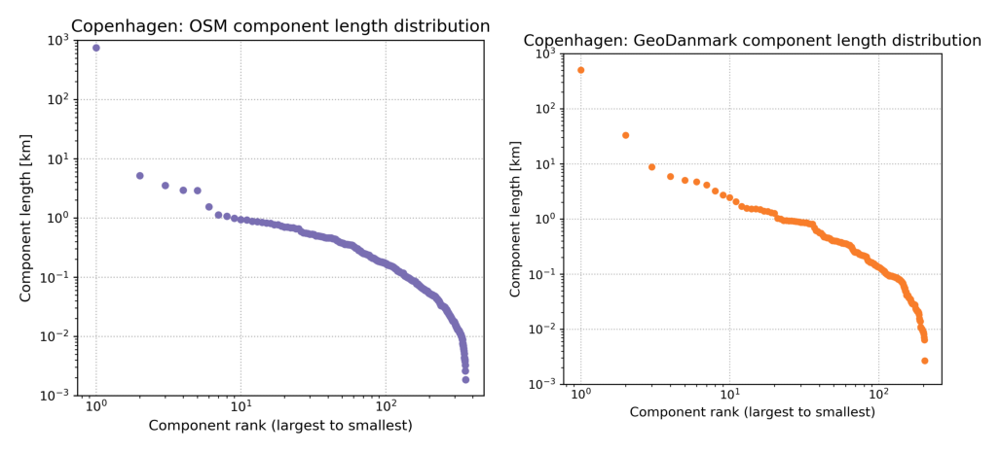

In [31]:
plot_func.plot_saved_maps(
    [
        osm_results_plots_fp + "component_length_distribution_osm",
        ref_results_plots_fp + "component_length_distribution_reference",
    ],
    figsize=pdict["fsmap"]
)

### 最大连通分量

In [32]:
# Read largest cc
osm_largest_cc = gpd.read_file(osm_results_data_fp + "largest_connected_component.gpkg")
ref_largest_cc = gpd.read_file(ref_results_data_fp + "largest_connected_component.gpkg")

print(
    f"The largest connected component in the OSM network contains {osm_intrinsic_results['component_analysis']['largest_cc_pct_size']:.2f}% of the network length."
)
print(
    f"The largest connected component in the {reference_name} network contains {ref_intrinsic_results['component_analysis']['largest_cc_pct_size']:.2f}% of the network length."
)

The largest connected component in the OSM network contains 91.47% of the network length.
The largest connected component in the GeoDanmark network contains 80.04% of the network length.


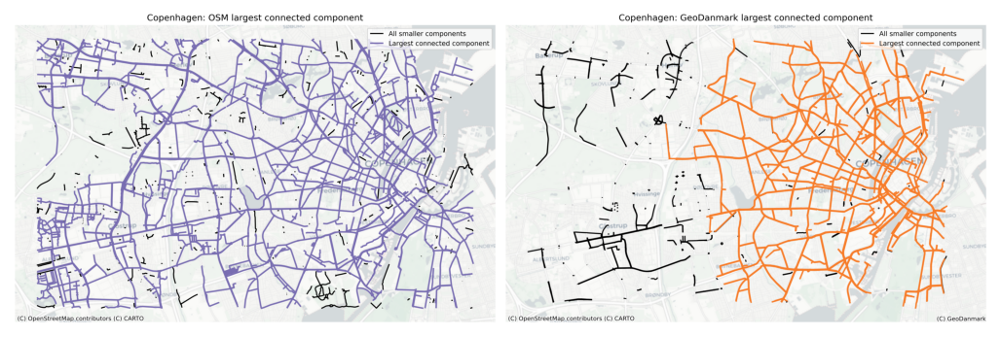

In [33]:
plot_func.plot_saved_maps(
    [
        osm_results_static_maps_fp + "largest_conn_comp_osm",
        ref_results_static_maps_fp + "largest_conn_comp_reference",
    ]
)

**OSM 和参考网络中最大连接组件的叠加**

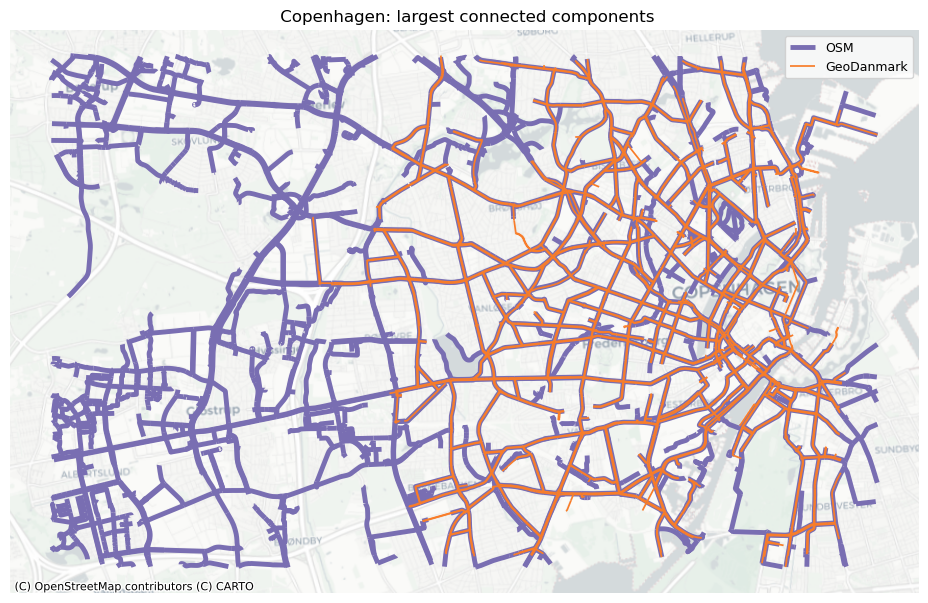

In [34]:
# Plot

set_renderer(renderer_map)
fig, ax = plt.subplots(1, figsize=pdict["fsmap"])

osm_largest_cc.plot(ax=ax, linewidth=3.5, color=pdict["osm_base"], label="OSM")
ref_largest_cc.plot(ax=ax, linewidth=1.25, color=pdict["ref_base"], label=reference_name)

ax.set_title(f" {area_name}: largest connected components")
ax.set_axis_off()
ax.legend()
cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)

plot_func.save_fig(fig, compare_results_static_maps_fp + "largest_cc_overlay_compare")

In [35]:
# Plot again for potential report titlepage

set_renderer(renderer_map)
fig, ax = plt.subplots(1, figsize=pdict["fsmap"])

osm_largest_cc.plot(ax=ax, linewidth=3, color=pdict["osm_base"], label="OSM")
ref_largest_cc.plot(ax=ax, linewidth=1, color=pdict["ref_base"], label=reference_name)
ax.set_axis_off()

plot_func.save_fig(fig, compare_results_static_maps_fp + "titleimage",plot_res="high")
plt.close()

### 缺少链接
在组件之间潜在缺失链接的图中，将绘制与另一个组件上的边的指定距离内的所有边。 断开的边缘之间的间隙用标记突出显示。 因此，该地图突出显示了边缘，尽管这些边缘彼此非常接近，但它们是断开连接的，因此不可能在边缘之间的自行车基础设施上骑自行车。

In [36]:
# DEFINE MAX BUFFER DISTANCE BETWEEN COMPONENTS CONSIDERED A GAP/MISSING LINK
component_min_distance = 10

assert isinstance(component_min_distance, int) or isinstance(
    component_min_distance, float
), print("Setting must be integer or float value!")

In [37]:
# Read results with component gaps

osm_cg_edge_ids = pd.read_csv(
    osm_results_data_fp + f"component_gaps_edges_{component_min_distance}.csv"
)["edge_id"].to_list()
osm_component_gaps_edges = osm_edges_simplified.loc[
    osm_edges_simplified.edge_id.isin(osm_cg_edge_ids)
]

ref_cg_edge_ids = pd.read_csv(
    ref_results_data_fp + f"component_gaps_edges_{component_min_distance}.csv"
)["edge_id"].to_list()
ref_component_gaps_edges = ref_edges_simplified.loc[
    ref_edges_simplified.edge_id.isin(ref_cg_edge_ids)
]

osm_component_gaps = gpd.read_file(
    osm_results_data_fp + f"component_gaps_centroids_{component_min_distance}.gpkg"
)
ref_component_gaps = gpd.read_file(
    ref_results_data_fp + f"component_gaps_centroids_{component_min_distance}.gpkg"
)

In [38]:
# Interactive plot of adjacent components

feature_groups = []

if len(osm_component_gaps_edges) > 0:

    # Feature groups for OSM
    osm_edges_simplified_folium = plot_func.make_edgefeaturegroup(
        gdf=osm_edges_simplified,
        mycolor=pdict["osm_base"],
        myweight=pdict["line_base"],
        nametag="OSM network",
        show_edges=True,
    )

    osm_component_gaps_edges_folium = plot_func.make_edgefeaturegroup(
        gdf=osm_component_gaps_edges,
        mycolor=pdict["osm_emp"],
        myweight=pdict["line_emp"],
        nametag="OSM: Adjacent disconnected edges",
        show_edges=True,
    )

    osm_component_gaps_folium = plot_func.make_markerfeaturegroup(
        gdf=osm_component_gaps, nametag="OSM: Component gaps", show_markers=True
    )

    feature_groups.extend(
        [
            osm_edges_simplified_folium,
            osm_component_gaps_edges_folium,
            osm_component_gaps_folium,
        ]
    )

# Feature groups for reference
if len(ref_component_gaps_edges) > 0:

    ref_edges_simplified_folium = plot_func.make_edgefeaturegroup(
        gdf=ref_edges_simplified,
        mycolor=pdict["ref_base"],
        myweight=pdict["line_base"],
        nametag=f"{reference_name} network",
        show_edges=True,
    )

    ref_component_gaps_edges_folium = plot_func.make_edgefeaturegroup(
        gdf=ref_component_gaps_edges,
        mycolor=pdict["ref_emp"],
        myweight=pdict["line_emp"],
        nametag=f"{reference_name}: Adjacent disconnected edges",
        show_edges=True,
    )

    ref_component_gaps_folium = plot_func.make_markerfeaturegroup(
        gdf=ref_component_gaps, nametag=f"{reference_name}: Component gaps", show_markers=True
    )

    feature_groups.extend(
        [
            ref_edges_simplified_folium,
            ref_component_gaps_edges_folium,
            ref_component_gaps_folium,
        ]
    )

m = plot_func.make_foliumplot(
    feature_groups=feature_groups,
    layers_dict=folium_layers,
    center_gdf=osm_nodes_simplified,
    center_crs=osm_nodes_simplified.crs,
)

bounds = plot_func.compute_folium_bounds(osm_nodes_simplified)
m.fit_bounds(bounds)
m.save(compare_results_inter_maps_fp + "component_gaps_compare.html")

display(m)

In [39]:
print("Interactive map saved at " + compare_results_inter_maps_fp.lstrip("../") + "component_gaps_compare.html")

Interactive map saved at results/COMPARE/cph_geodk/maps_interactive/component_gaps_compare.html


### 每个网格单元的组件

下图显示了与网格单元相交的组件数量。 网格单元中的组件数量过多通常表明网络连接较差 - 要么是由于基础设施分散，要么是因为数据质量问题。

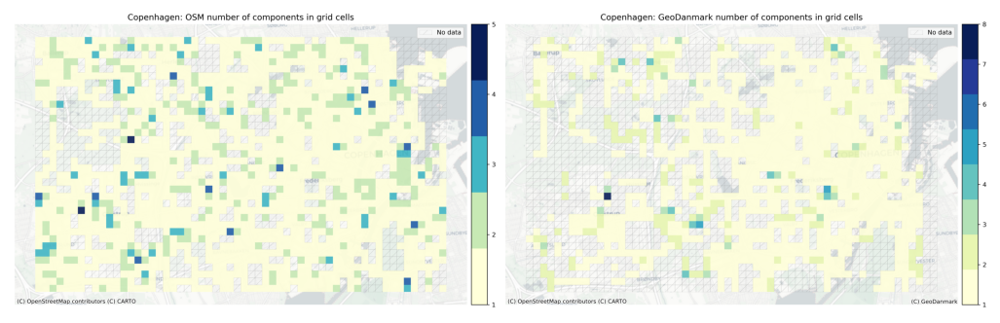

In [40]:
plot_func.plot_saved_maps(
    [
        osm_results_static_maps_fp + "number_of_components_in_grid_cells_osm",
        ref_results_static_maps_fp + "number_of_components_in_grid_cells_reference",
    ]
)

### 组件连接

在这里，我们可视化每个单元格可以到达的单元格数量之间的差异。 该指标是网络连接性的粗略衡量标准，但具有计算成本低的优点，因此能够快速突出网络连接性的明显差异。

在显示到达的细胞百分比差异的图中，正值表示使用参考数据集的连接性较高，而负值表示可以从 OSM 数据中的特定细胞到达更多的细胞。

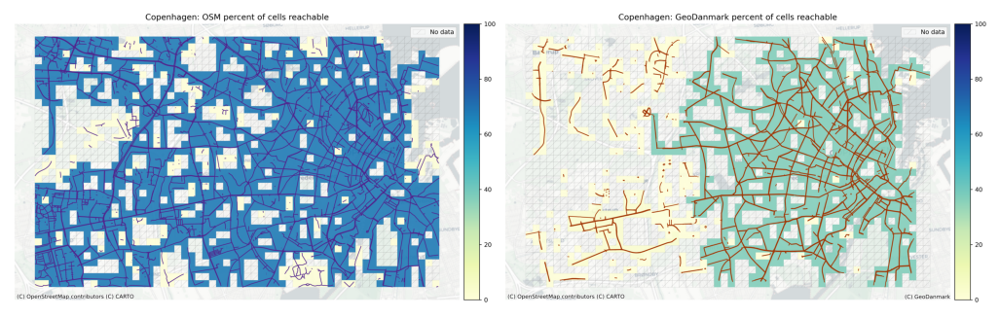

In [41]:
plot_func.plot_saved_maps(
    [
        osm_results_static_maps_fp + "percent_cells_reachable_grid_osm",
        ref_results_static_maps_fp + "percent_cells_reachable_grid_reference",
    ]
)

In [42]:
# Compute difference in cell reach percentage (where data for both OSM and REF is available)

grid["cell_reach_pct_diff"] = (
    grid["cells_reached_ref_pct"] - grid["cells_reached_osm_pct"]
)

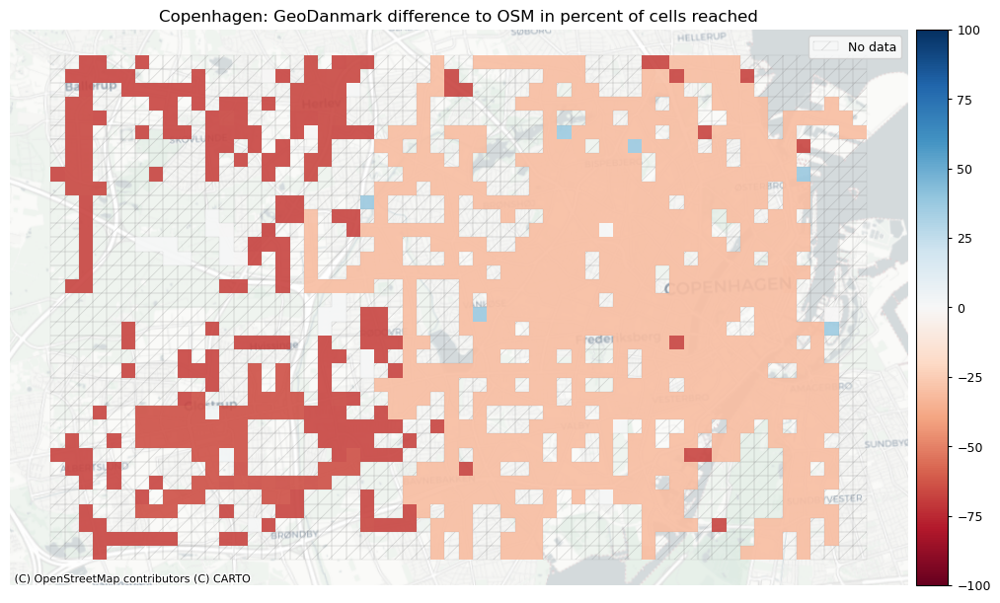

In [43]:
# Plot

set_renderer(renderer_map)

# norm color bar
cbnorm_diff = colors.Normalize(vmin=-100, vmax=100)

fig, ax = plt.subplots(1, figsize=pdict["fsmap"])
from mpl_toolkits.axes_grid1 import make_axes_locatable
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="3.5%", pad="1%")

grid.plot(
    cax=cax,
    ax=ax,
    alpha=pdict["alpha_grid"],
    column="cell_reach_pct_diff",
    cmap=pdict["diff"],
    legend=True,
    norm=cbnorm_diff,
)

# Add no data patches
grid[grid["cell_reach_pct_diff"].isnull()].plot(
    cax=cax,
    ax=ax,
    facecolor=pdict["nodata_face"],
    edgecolor=pdict["nodata_edge"],
    linewidth= pdict["line_nodata"],
    hatch=pdict["nodata_hatch"],
    alpha=pdict["alpha_nodata"],
)

# osm_edges_simplified.plot(ax=ax, color=pdict["osm_base"], alpha=1,linewidth=2)
# ref_edges_simplified.plot(ax=ax, color=pdict["ref_base"], alpha=1,linewidth=1)

ax.legend(handles=[nodata_patch], loc="upper right")

ax.set_title(
    f"{area_name}: {reference_name} difference to OSM in percent of cells reached"
)
ax.set_axis_off()
cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)

plot_func.save_fig(fig, compare_results_static_maps_fp + "percent_cell_reached_diff_compare")

## 概括

In [44]:
# Load results from intrinsic
osm_intrinsic_df = pd.read_csv(
    osm_results_data_fp + "intrinsic_summary_results.csv",
    index_col=0,
    names=["OSM"],
    header=0,
)

ref_intrinsic_df = pd.read_csv(
    ref_results_data_fp + "intrinsic_summary_results.csv",
    index_col=0,
    names=[reference_name],
    header=0,
)

# Drop rows from OSM results not available for reference
osm_intrinsic_df.drop(
    ["Incompatible tag combinations", "Missing intersection nodes"],
    axis=0,
    inplace=True,
)

# Save new results
osm_intrinsic_df.at["Alpha", "OSM"] = osm_alpha
osm_intrinsic_df.at["Beta", "OSM"] = osm_beta
osm_intrinsic_df.at["Gamma", "OSM"] = osm_gamma

ref_intrinsic_df.at["Alpha", reference_name] = ref_alpha
ref_intrinsic_df.at["Beta", reference_name] = ref_beta
ref_intrinsic_df.at["Gamma", reference_name] = ref_gamma

# Combine
extrinsic_df = osm_intrinsic_df.join(ref_intrinsic_df)
assert len(extrinsic_df) == len(osm_intrinsic_df) == len(ref_intrinsic_df)
extrinsic_df.style.pipe(format_extrinsic_style)

,OSM,GeoDanmark
Total infrastructure length (km),"1,056",626
Protected bicycle infrastructure density (m/km2),"5,342","2,999"
Unprotected bicycle infrastructure density (m/km2),427,455
Mixed protection bicycle infrastructure density (m/km2),55,0
Bicycle infrastructure density (m/km2),"5,825","3,454"
Nodes,"5,016","4,125"
Dangling nodes,"1,828",870
Nodes per km2,28,23
Dangling nodes per km2,10,5
Overshoots,8,21


## 保存结果

In [45]:
extrinsic_df.to_csv(
    compare_results_data_fp + "extrinsic_summary_results.csv", index=True
)

with open(
    compare_results_data_fp + f"grid_results_extrinsic.pickle", "wb"
) as f:
    pickle.dump(grid, f)

***

In [46]:
from time import strftime
print("Time of analysis: " + strftime("%a, %d %b %Y %H:%M:%S"))

Time of analysis: Mon, 18 Dec 2023 20:25:24
